# <font color='lightgreen'>NLP project part 1</font>

# Imports and functions

In [15]:
import pandas as pd 
import numpy as np
import math
#connect to drive
#from google.colab import drive
# datetime
import datetime
# visualisation
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objects as go
import ipywidgets as widgets
import matplotlib.pyplot as plt 
from wordcloud import WordCloud
#string to list
import ast
#tokanization, pos
import nltk
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
#stop words 
from nltk.corpus import stopwords
nltk.download('stopwords')
#NER name entity
import spacy
import spacy.cli 
spacy.cli.download("en_core_web_sm")
#remove punct
import re

[nltk_data] Downloading package punkt to /home/mao/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/mao/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package stopwords to /home/mao/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
2023-05-19 16:58:40.217091: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
DEPRECATION: https://github.com/explosion/spacy-models/releases/download/en_core_web_sm-3.2.0/en_core_web_sm-3.2.0-py3-none-any.whl#egg=en_core_web_sm==3.2.0 contains an egg fragment with a non-PEP 508 name pip 25.0 will enforce this behaviour change. A possible replacement is to use the req @ url syntax, and remove the egg fragment. Discussion can be found at https://github.com/pypa/pip/issues/11617


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.9/13.9 MB 32.1 MB/s eta 0:00:00
  Using cached pydantic-1.8.2-cp38-cp38-manylinux2014_x86_64.whl (13.7 MB)
  Attempting uninstall: pydantic
    Found existing installation: pydantic 1.10.7
    Uninstalling pydantic-1.10.7:
      Successfully uninstalled pydantic-1.10.7
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
trend-classifier 0.1.8 requires numpy<2.0.0,>=1.23.2, but you have numpy 1.20.3 which is incompatible.
trend-classifier 0.1.8 requires pydantic<2.0.0,>=1.10.1, but you have pydantic 1.8.2 which is incompatible.


In [16]:
# sepaearte numric and categorial features
def get_lists_of_categorial_and_numeric_feature(df,unique_id_col_name="id",label_col_name="label"):
  list_num_cols=list(df.describe().columns.values)
  list_num_cols.remove(unique_id_col_name)
  list_all_cols=list(df.columns.values)
  list_all_cols.remove(label_col_name) # ignoring label for vis purposes
  list_all_cols.remove(unique_id_col_name)
  list_cat_cols=[i for i in list_all_cols if i not in list_num_cols] # categorial cols are all the cols that are not numeric - make sure label is not numeric! date data are relevant as categorial
  return list_cat_cols,list_num_cols

In [17]:
# Visualisation of categorial features
def vis_label_dist_categorial_features(df,label_col_name,unique_id_col_name,categorial_col_list,numeric_label_col_name):
  
  for col in categorial_col_list:
    print("\n feature name: ",col)
    basic_temp_grouped=df.groupby([col])[unique_id_col_name].count().reset_index(name="count")
    print("number of categories: ",basic_temp_grouped.shape[0])
    if(basic_temp_grouped.shape[0]<120): #if cardenality is low. number of values is lower than 120
      display(basic_temp_grouped)
      fig1 = px.bar(basic_temp_grouped.sort_values(by=[col]), x=col, y="count", color=col, title=col+" distrabution",text_auto=True,color_discrete_sequence=px.colors.qualitative.Pastel)
      fig1.show()

      temp_grouped=df.groupby([col,label_col_name])[unique_id_col_name].count().reset_index(name="count")
      temp_grouped[label_col_name]=temp_grouped[label_col_name].astype(str)
      temp_grouped['percent_label'] = 100 * temp_grouped['count'] / temp_grouped.groupby(col)['count'].transform('sum')

      fig2 = px.bar(temp_grouped, x=col, y="percent_label",title="label split per "+col, color=label_col_name, text=temp_grouped['percent_label'],color_discrete_sequence=px.colors.qualitative.Pastel)
      fig2.update_traces(texttemplate='%{text:.4}%')
      fig2.show()
    else:
      temp_grouped_basic_hist=raw_train.groupby([col])[numeric_label_col_name].agg(['count','mean']).reset_index()
      temp_grouped_basic_hist = temp_grouped_basic_hist.rename({'mean': 'percent_true'}, axis=1)       
      fig88 = px.histogram(temp_grouped_basic_hist, x="percent_true",title='histogram - number of '+col+"per percent of true clicked")
      fig88.add_vline(x=0.067, line_width=3, line_dash="dash", line_color="black",annotation_text="rate across all data")
      fig88.show()
      fig77 = px.histogram(temp_grouped_basic_hist, x="percent_true", y="count", histfunc='sum',title='sum of count of '+col+' per percent of true clicked')
      fig77.add_vline(x=0.067, line_width=3, line_dash="dash", line_color="black",annotation_text="rate across all data")
      fig77.show()

In [18]:
# aggregate values of categorial feature with high cardenality (any vlaue that appears less than a spesific percent is becoming "other")
def aggregate_other_group_for_high_cardenality_handeling (df,cat_coulmn_name,grouped_col_name,over_percent=0.01):
  new_df=df.copy()
  new_df['percent']=new_df.groupby(cat_coulmn_name)[cat_coulmn_name].transform('size')/new_df.shape[0]
  new_df[grouped_col_name]=new_df[cat_coulmn_name]
  new_df[grouped_col_name].loc[new_df['percent']<over_percent]='other'
  return new_df

In [19]:
#given text tokens and a list - count number of tokens that are in the list
def count_words_from_list(text_tokens,list_of_words):
  count=0
  for w in text_tokens:
    if w in list_of_words:
      count=count+1
  return count

In [20]:
#get list of the words (ner label) that are name entities
def spacy_large_ner_label(document):
  return [( ent.label_) for ent in sp_sm(document).ents]

In [21]:
#get list of the words (text) that are name entities
def spacy_large_ner_text(document):
  return [(ent.text.strip()) for ent in sp_sm(document).ents]

In [22]:
# create wordcloud graph to see the common words per label
def make_wordcloud(words,title):
    cloud = WordCloud(width=1920, height=1080,max_font_size=200, max_words=350, background_color="white").generate(words)
    plt.figure(figsize=(20,20))
    plt.imshow(cloud, interpolation="gaussian")
    plt.axis("off") 
    plt.title(title, fontsize=60)
    plt.show()

In [23]:
# for each words that's not on the list, lower and remove punctuations
def lower_and_remove_punct_excpet_listed(sentence,list_words_not_to_lower):
  words=sentence.split()
  new_str_lst=[]
  for w in words:
    if w not in list_words_not_to_lower:
      lowered = w.lower()
      clean = re.sub(r'[^\w\s]', '', lowered)
      new_str_lst.append(clean)
    else:
      new_str_lst.append(w)
  new_str=" ".join(new_str_lst)
  return(new_str)

In [24]:
def pos_tagger(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return wordnet.VERB
    elif nltk_tag.startswith('N'):
        return wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return wordnet.ADV
    else:         
        return None

In [25]:
def organize_pos_tags(pos_tagged):
  return list(map(lambda x: (x[0], pos_tagger(x[1])), pos_tagged))

In [26]:
def lemmatize_with_pos(wordnet_tagged):
  lemmatized_sentence = []
  for word, tag in wordnet_tagged:
      if tag is None:
          # if there is no available tag, append the token as is
          lemmatized_sentence.append(word)
      else:       
          # else use the tag to lemmatize the token
          lemmatized_sentence.append(lemmatizer.lemmatize(word, tag))
  lemmatized_sentence = " ".join(lemmatized_sentence)
  return lemmatized_sentence

# Load data

In [27]:
# data is from : https://www.kaggle.com/datasets/therohk/ireland-historical-news?datasetId=30661
#drive.mount('/content/drive')
path = "/data/talya/nlp_project/data/ireland-news-headlines.csv"
df = pd.read_csv(path)
df=df.rename(columns={'headline_category':'label'})
print("Shape: ",df.shape)
print(df.isna().sum())
df.head()

Shape:  (1611495, 3)
publish_date     0
label            0
headline_text    7
dtype: int64


,publish_date,label,headline_text
0,19960102,news,UUP sees possibility of voting Major out
1,19960102,news,Pubs targeted as curbs on smoking are extended
2,19960102,news,Papers reveal secret links with O'Neill cabinet
3,19960102,news,Domestic chaos as Italy takes EU presidency
4,19960102,news,Learning about the star to which we owe life


In [28]:
df=df.dropna() # dropping na since it's only 7
print("Shape: ",df.shape)

Shape:  (1611488, 3)


In [29]:
# publish date to dateparts
df['date']=df.publish_date.apply(lambda x:datetime.datetime.strptime(str(x),'%Y%m%d').strftime('%Y-%m-%d'))
df['year']=df.date.apply(lambda x:x.split('-')[0])
df['month']=df.date.apply(lambda x:x.split('-')[1])
df["date"] = pd.to_datetime(df["date"])
df['day_name'] = df['date'].dt.day_name()
df['weekend_vs_midweek']='midweek'
df['weekend_vs_midweek'].loc[(df['day_name']=='Saturday') | (df['day_name']=='Sunday')]='weekend'
df['id'] = df.index

/tmp/ipykernel_4118043/216261403.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['weekend_vs_midweek'].loc[(df['day_name']=='Saturday') | (df['day_name']=='Sunday')]='weekend'


# Visualisation

## Visualisation of labels and time fatures

In [30]:
df_vis=df[['id','label','year','month','day_name','weekend_vs_midweek']]

In [31]:
list_cat_cols,list_num_cols=get_lists_of_categorial_and_numeric_feature(df_vis)

### Label distrabution

Unique Headlines Categories: 103


/tmp/ipykernel_4118043/2686667517.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grouped['label'].loc[grouped['percent']<0.01]='other'


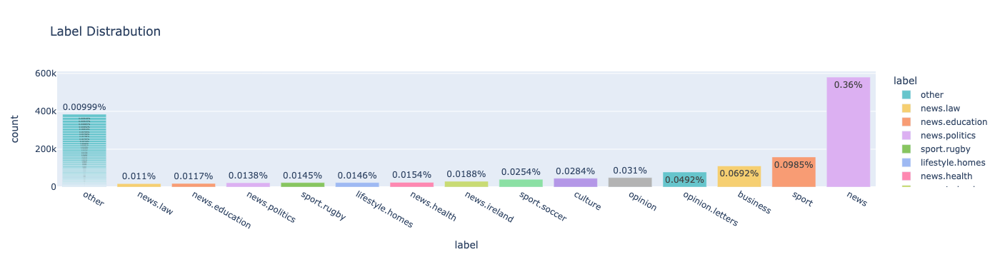

In [32]:
grouped=df_vis[['label','id']].groupby(by=["label"], dropna=False).count().reset_index().rename(columns={'id':'count'})
grouped['percent']=grouped['count']/df_vis.shape[0]
print('Unique Headlines Categories: {}'.format(len(grouped.label.unique())))
grouped['label'].loc[grouped['percent']<0.01]='other'

fig = px.bar(grouped.sort_values(by=['count']), x="label", y="count", color="label", text="percent",color_discrete_sequence=px.colors.qualitative.Pastel,title='Label Distrabution')
fig.update_traces(texttemplate='%{text:.3}%')
fig.show()

In [33]:
df_vis=aggregate_other_group_for_high_cardenality_handeling(df_vis,'label','grouped_label')
df_vis.head()

/tmp/ipykernel_4118043/1114074838.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,id,label,year,month,day_name,weekend_vs_midweek,percent,grouped_label
0,0,news,1996,01,Tuesday,midweek,0.360063,news
1,1,news,1996,01,Tuesday,midweek,0.360063,news
2,2,news,1996,01,Tuesday,midweek,0.360063,news
3,3,news,1996,01,Tuesday,midweek,0.360063,news
4,4,news,1996,01,Tuesday,midweek,0.360063,news


### Time feature


 feature name:  year
number of categories:  26


,year,count
0,1996,54744
1,1997,55340
2,1998,54593
3,1999,63515
4,2000,59273
5,2001,76639
6,2002,57052
7,2003,62132
8,2004,62405
9,2005,60520


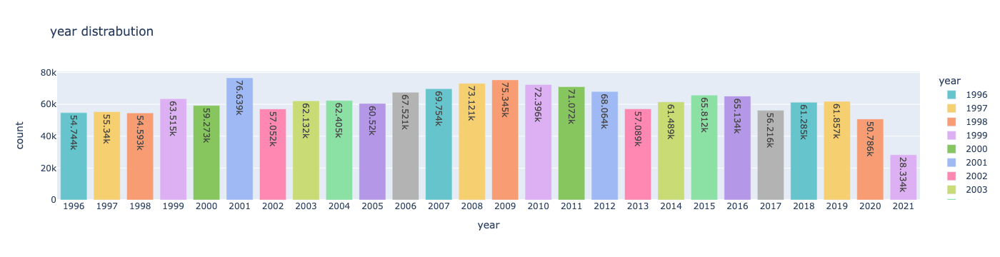

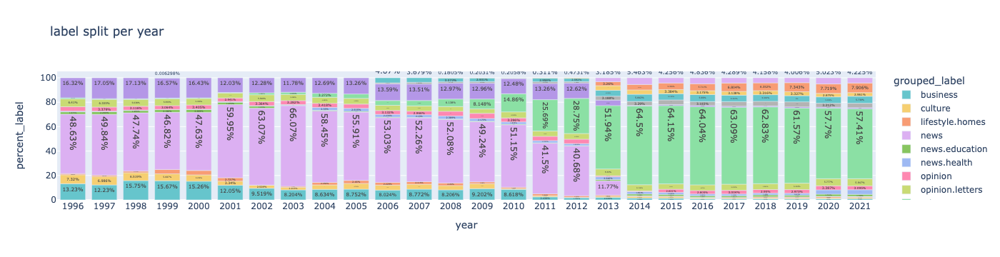


 feature name:  month
number of categories:  12


,month,count
0,01,137323
1,02,134351
2,03,140700
3,04,130489
4,05,144307
5,06,136603
6,07,133011
7,08,126814
8,09,133163
9,10,141028


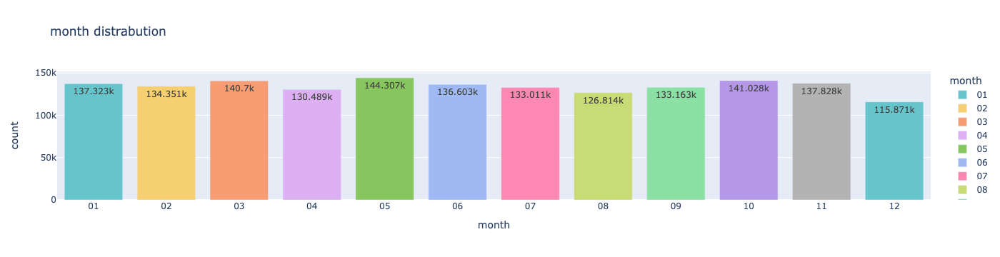

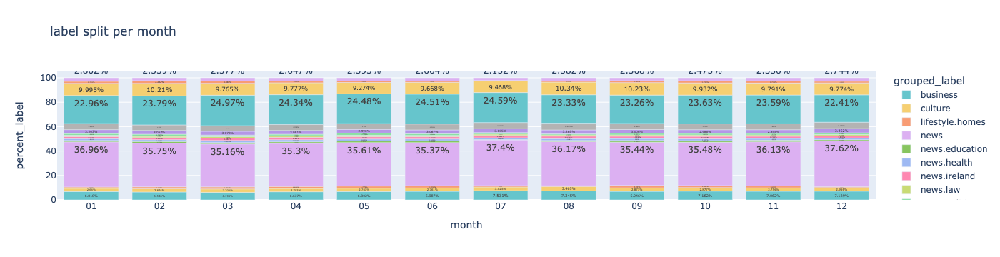


 feature name:  day_name
number of categories:  7


,day_name,count
0,Friday,278724
1,Monday,235502
2,Saturday,265326
3,Sunday,46946
4,Thursday,265329
5,Tuesday,259015
6,Wednesday,260646


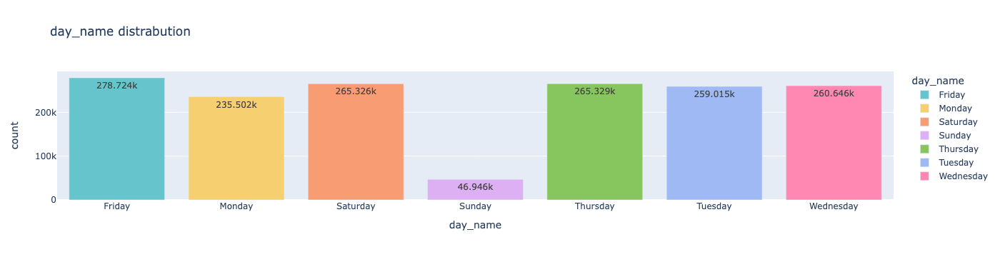

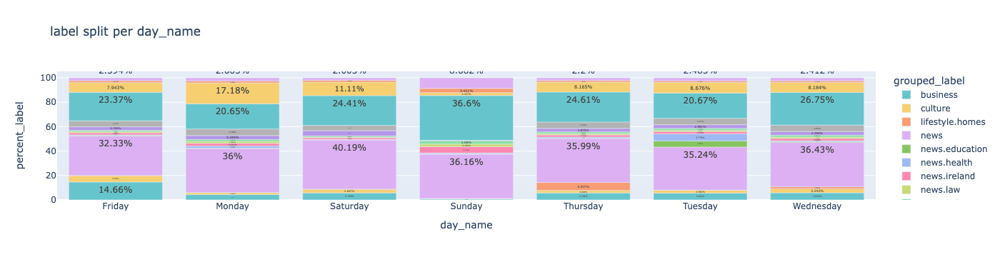


 feature name:  weekend_vs_midweek
number of categories:  2


,weekend_vs_midweek,count
0,midweek,1299216
1,weekend,312272


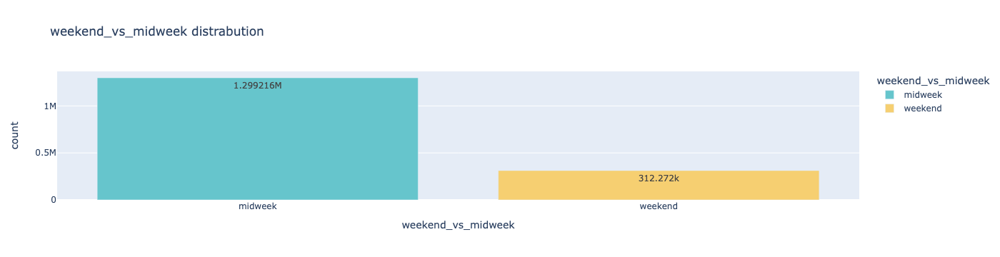

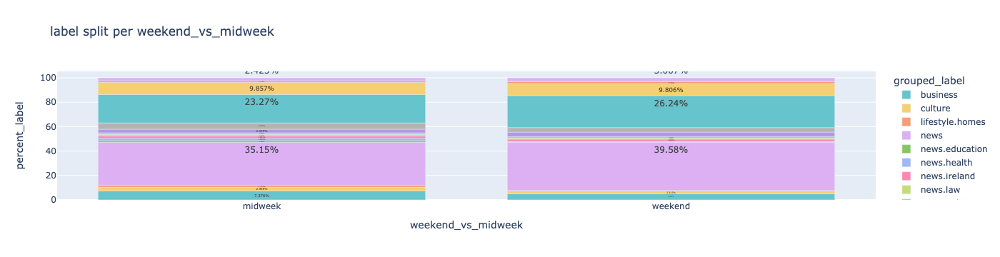

In [34]:
vis_label_dist_categorial_features(df_vis,'grouped_label','id',list_cat_cols,list_num_cols)

## Stop words visualization

In [ ]:
df=df[['id','headline_text','label']]

In [ ]:
df["headline_text"] = df["headline_text"].apply(lambda x: str(x))
df['tokenized'] = df['headline_text'].str.lower().apply(nltk.word_tokenize)

In [ ]:
stopwords = nltk.corpus.stopwords.words('english')
df['stop_words_count'] = df.tokenized.apply(lambda x: count_words_from_list(x,stopwords))
df['count_of_words']=df.tokenized.apply(lambda x: len(x))
df_sw=aggregate_other_group_for_high_cardenality_handeling(df,'label','grouped_label')

<ipython-input-15-1b73e561cd22>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[grouped_col_name].loc[new_df['percent']<over_percent]='other'


In [ ]:
grouped_sw=df_sw[['grouped_label','stop_words_count','count_of_words']].groupby(by=["grouped_label"], dropna=False).sum().reset_index()
grouped_sw['percent_of_stop_words']=grouped_sw['stop_words_count']/grouped_sw['count_of_words']

fig = px.bar(grouped_sw.sort_values(by=['percent_of_stop_words']), x="grouped_label", y="percent_of_stop_words", hover_data=['stop_words_count','count_of_words'],text="percent_of_stop_words",color_discrete_sequence=px.colors.qualitative.Pastel,title='Percent of stop words per category')
fig.update_traces(texttemplate='%{text:.3}%')
fig.show()

In [ ]:
df_sw['percent_of_stop_words']=df_sw['stop_words_count']/df_sw['count_of_words']
grouped_sw=df_sw[['grouped_label','stop_words_count','count_of_words','percent_of_stop_words']].groupby(by=["grouped_label"], dropna=False).mean().reset_index()

fig = px.bar(grouped_sw.sort_values(by=['percent_of_stop_words']), x="grouped_label", y="percent_of_stop_words", hover_data=['stop_words_count','count_of_words'],text="percent_of_stop_words",color_discrete_sequence=px.colors.qualitative.Pastel,title='AVG Percent of stop words per category')
fig.update_traces(texttemplate='%{text:.3}%')
fig.show()

As the the headlines are short sentances with ~7 words and the stop words are ~ 25% of it we decided not to remove stop words as part of the pre-processing in order to not loss important information.

## Unsupervised topics

In [ ]:
! pip install bertopic

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from bertopic import BERTopic
from sklearn.datasets import fetch_20newsgroups

In [ ]:
model = BERTopic()
opinion=df['headline_text'].loc[df['label']=='opinion'].tolist()
topics, probs = model.fit_transform(opinion)

In [ ]:
# model.get_topic_freq()
model.get_topic_info()

,Topic,Count,Name
0,-1,12812,-1_ireland_irish_eu_of
1,0,4854,0_irishmans_diary_an_about
2,1,1419,1_turner_martyn_turners_frenetic
3,2,564,2_irishwomans_diary_an_queen
4,3,461,3_said_week_they_this
...,...,...,...
719,718,10,718_irishmans_diary_an_
720,719,10,719_gracious_victors_clearcut_wirral
721,720,10,720_watches_affinity_ripping_realised
722,721,10,721_ethnic_minorities_travellers_slavery


In [ ]:
# Visualize top topic keywords
model.visualize_barchart(top_n_topics=12)

In [ ]:
# Visualize connections between topics using hierachical clustering
model.visualize_hierarchy(top_n_topics=10)

In [ ]:
from umap import UMAP
import matplotlib

In [ ]:
def vis_bert_topics(docs,model):
  %matplotlib inline
  
  # Prepare data for plotting
  embeddings = model._extract_embeddings(docs, method="document")
  umap_model = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit(embeddings)
  df = pd.DataFrame(umap_model.embedding_, columns=["x", "y"])
  df["topic"] = topics
  
  # Plot parameters
  top_n = 10
  fontsize = 12
  
  # Slice data
  to_plot = df.copy()
  to_plot[df.topic >= top_n] = -1
  outliers = to_plot.loc[to_plot.topic == -1]
  non_outliers = to_plot.loc[to_plot.topic != -1]
  
  # Visualize topics
  cmap = matplotlib.colors.ListedColormap(['#FF5722', # Red
                                          '#03A9F4', # Blue
                                          '#4CAF50', # Green
                                          '#80CBC4', # FFEB3B
                                          '#673AB7', # Purple
                                          '#795548', # Brown
                                          '#E91E63', # Pink
                                          '#212121', # Black
                                          '#00BCD4', # Light Blue
                                          '#CDDC39', # Yellow/Red
                                          '#AED581', # Light Green
                                          '#FFE082', # Light Orange
                                          '#BCAAA4', # Light Brown
                                          '#B39DDB', # Light Purple
                                          '#F48FB1', # Light Pink
                                          ])
  
  # Visualize outliers + inliers
  fig, ax = plt.subplots(figsize=(15, 15))
  scatter_outliers = ax.scatter(outliers['x'], outliers['y'], c="#E0E0E0", s=1, alpha=.3)
  scatter = ax.scatter(non_outliers['x'], non_outliers['y'], c=non_outliers['topic'], s=1, alpha=.3, cmap=cmap)
  
  # Add topic names to clusters
  centroids = to_plot.groupby("topic").mean().reset_index().iloc[1:]
  for row in centroids.iterrows():
     topic = int(row[1].topic)
     text = f"{topic}: " + "_".join([x[0] for x in model.get_topic(topic)[:3]])
     ax.text(row[1].x, row[1].y*1.01, text, fontsize=fontsize, horizontalalignment='center')
  
  ax.text(0.99, 0.01, f"BERTopic - Top {top_n} topics", transform=ax.transAxes, horizontalalignment="right", color="black")
  plt.xticks([], [])
  plt.yticks([], [])
  plt.savefig("BERTopic_Example_Cluster_Plot.png")
  plt.show()


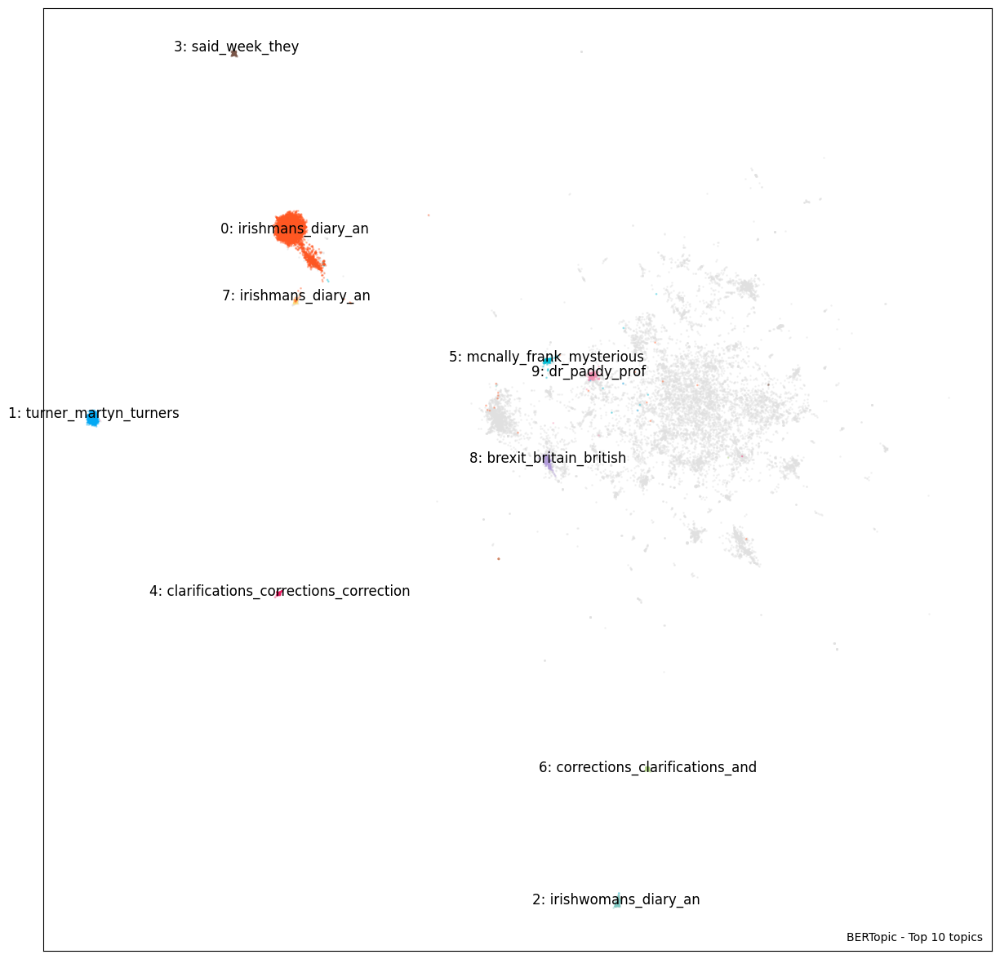

In [ ]:
vis_bert_topics(opinion,model)

## Name entities

In [ ]:
list_of_name_entites=['ORG', 'CARDINAL', 'DATE', 'GPE', 'PERSON', 'MONEY', 'PRODUCT', 'TIME', 'PERCENT', 'WORK_OF_ART', 'QUANTITY', 'NORP', 'LOC', 'EVENT', 'ORDINAL', 'FAC', 'LAW', 'LANGUAGE']


In [ ]:
sp_sm = spacy.load('en_core_web_sm')
# add ner entity label and text 
df['ner']=df.headline_text.apply(lambda x:spacy_large_ner_label(x))
df['ner_text']=df.headline_text.apply(lambda x:spacy_large_ner_text(x))

In [ ]:
# #saved processed df
# drive.mount('/content/drive')
# path = "/content/drive/MyDrive/advanced deep learning/project/data_files/ner_stop_word_full.csv"
# df=pd.read_csv(path)
# df.drop(['Unnamed: 0'], axis='columns', inplace=True)
# df['ner']=df.ner.apply(lambda x: ast.literal_eval(x))
# df['ner_text']=df.ner_text.apply(lambda x: ast.literal_eval(x))
# df=df.loc[df['label']!='False']

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df['count_of_ners']=df.ner.apply(lambda x: len(x))
df['has_ner']='True'
df.loc[df['count_of_ners']==0]='False'

In [ ]:
# pie chart distrabution of headlines with at least one name entity
fig = px.pie(df, names='has_ner',color_discrete_sequence=[ 'salmon', 'navy'],title='Percent of headlines with at least one name entity') # Setting Heart_ stroke as the label
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [ ]:
ne_exploded=df.explode('ner') #duplicate rows per each ner per row ( a row with ['ORG','PERSON'] would split into 2 rows)
clean_ne_eploded=ne_exploded.loc[ne_exploded['label']!='False']
grouped_ne=clean_ne_eploded[['label','ner','count_of_ners']].groupby(by=["label","ner"], dropna=False).count().reset_index()
grouped_ne['Percentage']=100 * grouped_ne['count_of_ners'] / grouped_ne.groupby('label')['count_of_ners'].transform('sum')
grouped_ne.head(100)
#how many
fig = px.bar(grouped_ne, x="label", y="Percentage",color='ner',text='Percentage',color_discrete_sequence=px.colors.qualitative.Pastel,title='Percent of ner per label (all labels) and ner type')
fig.update_traces(texttemplate='%{text:.4}%')
fig.show()


In [ ]:
df_ner=aggregate_other_group_for_high_cardenality_handeling(df,'label','grouped_label')

<ipython-input-40-1b73e561cd22>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
ne_exploded2=df_ner.explode('ner') #duplicate rows per each ner per row ( a row with ['ORG','PERSON'] would split into 2 rows)
clean_ne_eploded=ne_exploded2.loc[ne_exploded2['grouped_label']!='False']
grouped_ne=clean_ne_eploded[['grouped_label','ner','count_of_ners']].groupby(by=["grouped_label","ner"], dropna=False).count().reset_index()
grouped_ne['Percentage']=100 * grouped_ne['count_of_ners'] / grouped_ne.groupby('grouped_label')['count_of_ners'].transform('sum')
grouped_ne.head(100)
#how many
fig = px.bar(grouped_ne, x="grouped_label", y="Percentage",color='ner',text='Percentage',color_discrete_sequence=px.colors.qualitative.Pastel,title='Percent of ner per label (top labels in count) and ner type')
fig.update_traces(texttemplate='%{text:.4}%')
fig.show()

In [ ]:
# explanation of the entites types
for entity in list_of_name_entites:
  print(entity,":",spacy.explain(entity))

ORG : Companies, agencies, institutions, etc.
CARDINAL : Numerals that do not fall under another type
DATE : Absolute or relative dates or periods
GPE : Countries, cities, states
PERSON : People, including fictional
MONEY : Monetary values, including unit
PRODUCT : Objects, vehicles, foods, etc. (not services)
TIME : Times smaller than a day
PERCENT : Percentage, including "%"
WORK_OF_ART : Titles of books, songs, etc.
QUANTITY : Measurements, as of weight or distance
NORP : Nationalities or religious or political groups
LOC : Non-GPE locations, mountain ranges, bodies of water
EVENT : Named hurricanes, battles, wars, sports events, etc.
ORDINAL : "first", "second", etc.
FAC : Buildings, airports, highways, bridges, etc.
LAW : Named documents made into laws.
LANGUAGE : Any named language


In [ ]:
ne_text_exploded=df_ner.explode('ner_text') #duplicate rows per each ner per row ( a row with ['ORG','PERSON'] would split into 2 rows)
ne_text_exploded=aggregate_other_group_for_high_cardenality_handeling(ne_text_exploded,'ner_text','grouped_ner_text',0.001)
clean_ne_text_exploded=ne_text_exploded.loc[ne_text_exploded['grouped_label']!='False']

grouped_ne=clean_ne_text_exploded[['grouped_label','grouped_ner_text','count_of_ners']].groupby(by=["grouped_label","grouped_ner_text"], dropna=False).count().reset_index()
grouped_ne['Percentage']=100 * grouped_ne['count_of_ners'] / grouped_ne.groupby('grouped_label')['count_of_ners'].transform('sum')
grouped_ne.head(100)
#how many
fig = px.bar(grouped_ne, x="grouped_label", y="Percentage",color='grouped_ner_text',text='Percentage',color_discrete_sequence=px.colors.qualitative.Pastel,title='Percent of ner per label (top labels in count) and ner type')
fig.update_traces(texttemplate='%{text:.4}%')
fig.show()

<ipython-input-40-1b73e561cd22>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#noticing there's a lot of headlines of opnion label with the exact text: AN IRISHMAN'S DIARY, no other label to this text
print("There are ",df.loc[(df['label']=='opinion') & (df['headline_text']=="AN IRISHMAN'S DIARY")].shape[0]," rows with the header -AN IRISHMAN'S DIARY- and the label opinion")
print("There are ",df.loc[(df['label']!='opinion') & (df['headline_text']=="AN IRISHMAN'S DIARY")].shape[0]," rows with the header -AN IRISHMAN'S DIARY- and the label is not opinion")


There are  402  rows with the header -AN IRISHMAN'S DIARY- and the label opinion
There are  0  rows with the header -AN IRISHMAN'S DIARY- and the label is not opinion


With ~70% of our data including name entitiy it's important to adress those in the pre-processing, we decided to not lower those and not remove thier punctuations in order to keep thier context.

## Common words per label

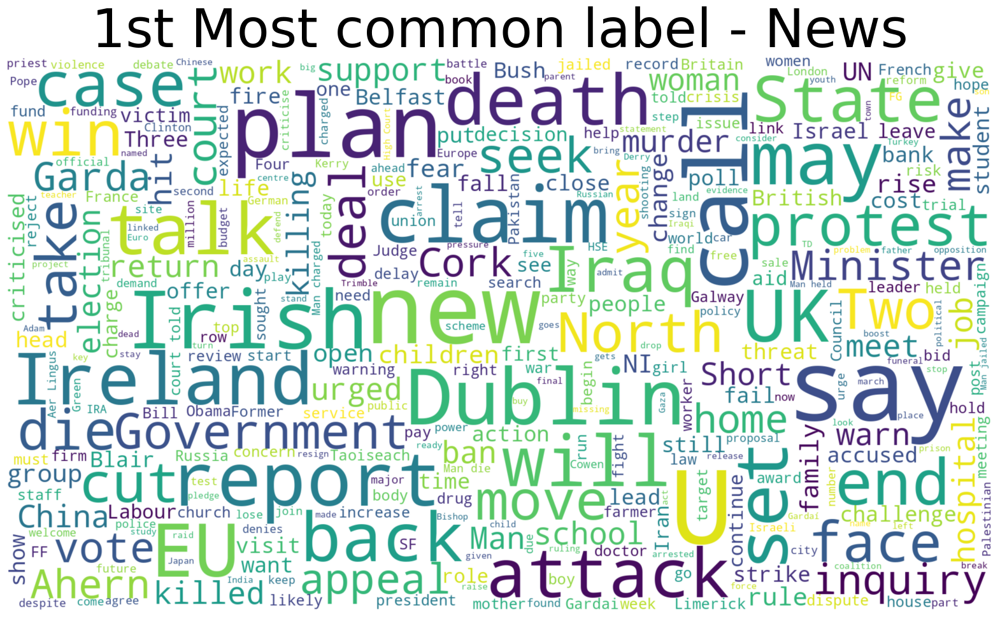

In [ ]:
# 1st Most common label
all_news_text = " ".join(df[df.label == "news"].headline_text) 
make_wordcloud(all_news_text, "1st Most common label - News")

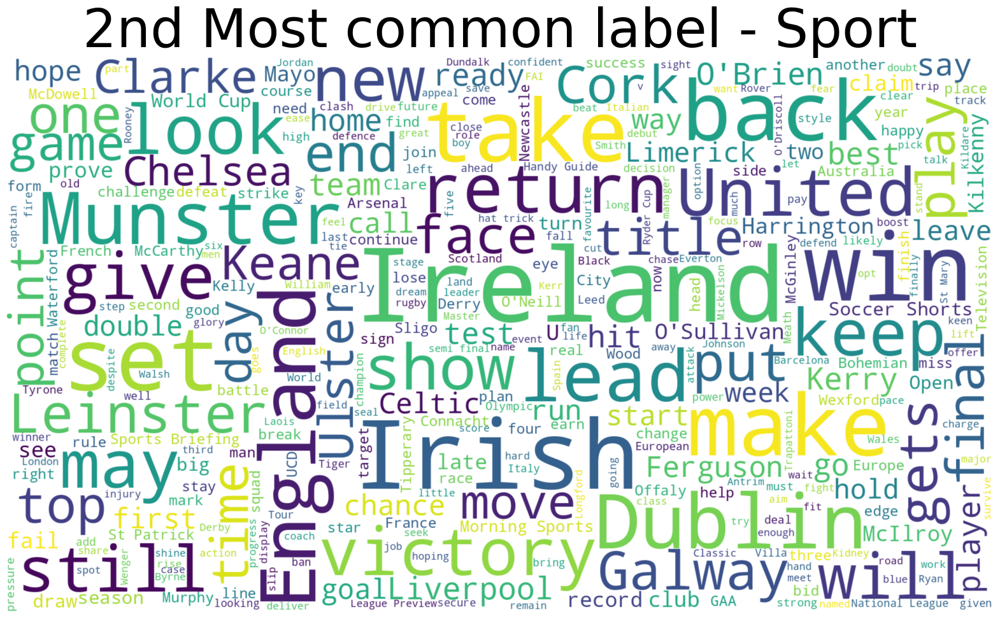

In [ ]:
# 2nd Most common label
all_news_text = " ".join(df[df.label == "sport"].headline_text) 
make_wordcloud(all_news_text, "2nd Most common label - Sport")

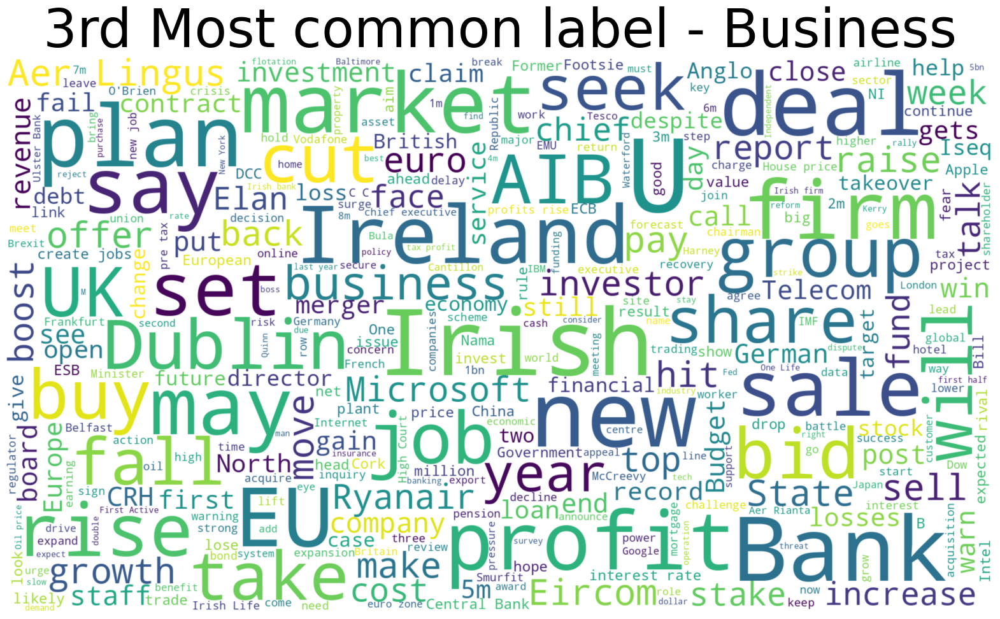

In [ ]:
# 3rd Most common label
all_news_text = " ".join(df[df.label == "business"].headline_text) 
make_wordcloud(all_news_text, "3rd Most common label - Business")

# Pre-proccessing

In [ ]:
df.head()

,id,headline_text,label,tokenized,stop_words_count,count_of_words,ner,ner_text
2,2,Papers reveal secret links with O'Neill cabinet,news,"['papers', 'reveal', 'secret', 'links', 'with'...",1,7,[ORG],[O'Neill]
3,3,Domestic chaos as Italy takes EU presidency,news,"['domestic', 'chaos', 'as', 'italy', 'takes', ...",1,7,"[GPE, ORG]","[Italy, EU]"
5,5,EU proposal for 'skills cards' to detail educa...,news,"['eu', 'proposal', 'for', ""'skills"", 'cards', ...",2,9,[ORG],[EU]
7,7,UCD cancels intake into evening course,news,"['ucd', 'cancels', 'intake', 'into', 'evening'...",1,6,"[GPE, TIME]","[UCD, evening]"
8,8,When days are seconds longer,news,"['when', 'days', 'are', 'seconds', 'longer']",2,5,[DATE],[days]


## Lower all leters and remove punctuations(except name entity)

In [ ]:
df['clean_headline_text']=df.apply(lambda x: lower_and_remove_punct_excpet_listed(x['headline_text'],x['ner_text']),axis=1)
df.head()

,id,headline_text,label,tokenized,stop_words_count,count_of_words,ner,ner_text,clean_headline_text
2,2,Papers reveal secret links with O'Neill cabinet,news,"['papers', 'reveal', 'secret', 'links', 'with'...",1,7,[ORG],[O'Neill],papers reveal secret links with O'Neill cabinet
3,3,Domestic chaos as Italy takes EU presidency,news,"['domestic', 'chaos', 'as', 'italy', 'takes', ...",1,7,"[GPE, ORG]","[Italy, EU]",domestic chaos as Italy takes EU presidency
5,5,EU proposal for 'skills cards' to detail educa...,news,"['eu', 'proposal', 'for', ""'skills"", 'cards', ...",2,9,[ORG],[EU],EU proposal for skills cards to detail education
7,7,UCD cancels intake into evening course,news,"['ucd', 'cancels', 'intake', 'into', 'evening'...",1,6,"[GPE, TIME]","[UCD, evening]",UCD cancels intake into evening course
8,8,When days are seconds longer,news,"['when', 'days', 'are', 'seconds', 'longer']",2,5,[DATE],[days],when days are seconds longer


## Lemmatization with context (pos)

In [ ]:
df['tokenized'] = df['clean_headline_text'].apply(nltk.word_tokenize)

In [ ]:
df.head()

,id,headline_text,label,tokenized,stop_words_count,count_of_words,ner,ner_text,clean_headline_text
2,2,Papers reveal secret links with O'Neill cabinet,news,"[papers, reveal, secret, links, with, O'Neill,...",1,7,[ORG],[O'Neill],papers reveal secret links with O'Neill cabinet
3,3,Domestic chaos as Italy takes EU presidency,news,"[domestic, chaos, as, Italy, takes, EU, presid...",1,7,"[GPE, ORG]","[Italy, EU]",domestic chaos as Italy takes EU presidency
5,5,EU proposal for 'skills cards' to detail educa...,news,"[EU, proposal, for, skills, cards, to, detail,...",2,9,[ORG],[EU],EU proposal for skills cards to detail education
7,7,UCD cancels intake into evening course,news,"[UCD, cancels, intake, into, evening, course]",1,6,"[GPE, TIME]","[UCD, evening]",UCD cancels intake into evening course
8,8,When days are seconds longer,news,"[when, days, are, seconds, longer]",2,5,[DATE],[days],when days are seconds longer


In [ ]:
from nltk.stem import WordNetLemmatizer
nltk.download('averaged_perceptron_tagger')
from nltk.corpus import wordnet
nltk.download('wordnet')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [ ]:
lemmatizer = WordNetLemmatizer()

In [ ]:
# get Part-of-speech 
df['pos_tag'] = df['tokenized'].apply(nltk.pos_tag)

In [ ]:
df.head()

,id,headline_text,label,tokenized,stop_words_count,count_of_words,ner,ner_text,clean_headline_text,pos_tag
2,2,Papers reveal secret links with O'Neill cabinet,news,"[papers, reveal, secret, links, with, O'Neill,...",1,7,[ORG],[O'Neill],papers reveal secret links with O'Neill cabinet,"[(papers, NNS), (reveal, VBP), (secret, JJ), (..."
3,3,Domestic chaos as Italy takes EU presidency,news,"[domestic, chaos, as, Italy, takes, EU, presid...",1,7,"[GPE, ORG]","[Italy, EU]",domestic chaos as Italy takes EU presidency,"[(domestic, JJ), (chaos, NN), (as, IN), (Italy..."
5,5,EU proposal for 'skills cards' to detail educa...,news,"[EU, proposal, for, skills, cards, to, detail,...",2,9,[ORG],[EU],EU proposal for skills cards to detail education,"[(EU, NNP), (proposal, NN), (for, IN), (skills..."
7,7,UCD cancels intake into evening course,news,"[UCD, cancels, intake, into, evening, course]",1,6,"[GPE, TIME]","[UCD, evening]",UCD cancels intake into evening course,"[(UCD, NNP), (cancels, NNS), (intake, VBP), (i..."
8,8,When days are seconds longer,news,"[when, days, are, seconds, longer]",2,5,[DATE],[days],when days are seconds longer,"[(when, WRB), (days, NNS), (are, VBP), (second..."


In [ ]:
#lematize
df['wordnet_tagged']=df['pos_tag'].apply(lambda x: organize_pos_tags(x))
df['clean_lemmatized_headlines']=df['wordnet_tagged'].apply(lambda x : lemmatize_with_pos(x))

In [ ]:
df['tokenized'] = df['clean_lemmatized_headlines'].apply(nltk.word_tokenize) # tokenize

In [ ]:
df_to_export=df[['clean_lemmatized_headlines','headline_text','tokenized','label']]

## Export to csv for model

In [ ]:
df_to_export.to_csv('clean_df_for_modeling.csv')
!cp clean_df_for_modeling.csv "/content/drive/MyDrive/advanced deep learning/project/clean_df_for_modeling.csv"

# Modeling

In [1]:
import pandas as pd

In [16]:
df = pd.read_csv('/data/talya/nlp_project/data/clean_df_for_modeling.csv')
df[1000:1010]

,Unnamed: 0,clean_lemmatized_headlines,headline_text,tokenized,label
1000,1395,strike threat over recruitment embargo,Strike threat over recruitment embargo,"['strike', 'threat', 'over', 'recruitment', 'e...",news
1001,1396,Muintir na tire to get 50000 for alert scheme,Muintir na Tire to get £50;000 for alert scheme,"['Muintir', 'na', 'tire', 'to', 'get', '50000'...",news
1002,1397,Garda search link to arson attack on alleged d...,Garda search linked to arson attacks on allege...,"['Garda', 'search', 'link', 'to', 'arson', 'at...",news
1003,1398,party press Owen to take tough action on crime,Parties press Owen to take tougher action on c...,"['party', 'press', 'Owen', 'to', 'take', 'toug...",news
1004,1399,living in fear of open prison,Living in fear of open prison,"['living', 'in', 'fear', 'of', 'open', 'prison']",news
1005,1400,Gardai be puzzle by murder victim route,Gardai are puzzled by murder victim's route,"['Gardai', 'be', 'puzzle', 'by', 'murder', 'vi...",news
1006,1401,hanafin ask court to rule divorce poll null an...,Hanafin asks court to rule divorce poll null a...,"['hanafin', 'ask', 'court', 'to', 'rule', 'div...",news
1007,1402,man shot in house at tallaght,Man shot in house at Tallaght,"['man', 'shot', 'in', 'house', 'at', 'tallaght']",news
1008,1403,34000 award for crash couple,£34;000 award for crash couple,"['34000', 'award', 'for', 'crash', 'couple']",news
1009,1404,lusk resident to lose water supply,Lusk resident to lose water supply,"['lusk', 'resident', 'to', 'lose', 'water', 's...",news


In [3]:
df['label'].nunique()

103

In [6]:
def extract_labels(data, level):
    labels = set()
    for category in data:
        parts = category.split('.')
        if len(parts) >= level:
            label = '.'.join(parts[:level])
            labels.add(label)
    return list(labels)

In [23]:
def extract_labels(data, level):
    labels = set()
    for category in data:
        parts = category.split('.')
        if len(parts) >= level:
            label = '.'.join(parts[:level])
            labels.add(label)
    return list(labels)

In [38]:
df[df['headline_text']== "Paper talk: 'Football punishes Barca. . . . Unjust; cruel; horrible; unmerited"]

,Unnamed: 0,clean_lemmatized_headlines,headline_text,tokenized,label
1056452,1056847,paper talk football punishes barca unjust crue...,Paper talk: 'Football punishes Barca. . . . Un...,"['paper', 'talk', 'football', 'punishes', 'bar...",sport


In [29]:
l = extract_labels(df['headline_text'], 0)
len(l)

1

In [30]:
l = extract_labels(df['headline_text'], 1)
len(l)

1512716

In [31]:
l = extract_labels(df['headline_text'], 2)
len(l)

31944

In [32]:
l = extract_labels(df['headline_text'], 3)
len(l)

5451

In [33]:
l = extract_labels(df['headline_text'], 4)
len(l)

5370

In [ ]:
l = extract_labels(df['headline_text'], 5)
l

In [ ]:
df['label'].unique()

In [3]:
df[['label_1', 'label_2', 'label_3', 'label_4']] = df['label'].str.split('.', expand=True)


In [4]:
df['label_3'].nunique()


32

In [5]:
df['label_4'].nunique()


6

In [9]:
df['label_1'].value_counts()

news         798476
sport        261781
business     222909
opinion      133005
culture       98917
lifestyle     96005
Name: label_1, dtype: int64

In [7]:
df[df['label_1'] == 'news']['label'].value_counts()

news                              580038
news.ireland                       30241
news.health                        24854
news.politics                      22313
news.education                     18835
news.law                           17801
news.world.europe                  14750
news.world.us                      10299
news.politics.oireachtas           10006
news.social                         8751
news.world.uk                       7678
news.environment                    7332
news.world.asia-pacific             6673
news.world.middle-east              5849
news.law.courts.high-court          4602
news.world                          4199
news.science                        3855
news.consumer                       3771
news.world.africa                   2998
news.social.beliefs                 2944
news.law.courts                     2817
news.law.courts.circuit-court       2641
news.law.courts.criminal-court      1710
news.law.courts.district-court      1493
news.offbeat    

In [8]:
df[df['label_1'] == 'sport']['label'].value_counts()

sport           158637
sport.soccer     40903
sport.rugby      23318
sport.others     14265
sport.gaelic     12371
sport.golf        6736
sport.racing      5551
Name: label, dtype: int64

In [9]:
df[df['label_1'] == 'business']['label'].value_counts()

business                            111384
business.technology                  16094
business.economy                     14796
business.financial-services          12783
business.commercial-property         12360
business.transport-and-tourism        7607
business.retail-and-services          7200
business.media-and-marketing          5341
business.markets                      4731
business.energy-and-resources         3977
business.agribusiness-and-food        3915
business.health-pharma                3156
business.personal-finance             3093
business.manufacturing                2733
business.economy.europe               2393
business.work                         2056
business.economy.ireland              1886
business.markets.equities             1766
business.construction                 1451
business.economy.world                1295
business.innovation                   1112
business.companies                     752
business.economy.public-finances       474
business.ec

In [11]:
df[df['label_1'] == 'opinion']['label'].value_counts()

opinion.letters      79229
opinion              49925
opinion.editorial     3851
Name: label, dtype: int64

In [12]:
df[df['label_1'] == 'culture']['label'].value_counts()

culture                        45772
culture.books                  13724
culture.music                  13195
culture.film                    8538
culture.tv-radio-web            3658
culture.stage                   3052
culture.music.album-reviews     2992
culture.heritage                2218
culture.design                  2185
culture.media                   1177
culture.treibh                  1174
culture.game-reviews             988
culture.tuarascail               244
Name: label, dtype: int64

In [13]:
df[df['label_1'] == 'lifestyle']['label'].value_counts()

lifestyle.homes                           23585
lifestyle.people                          12599
lifestyle.motors                          11564
lifestyle                                  9319
lifestyle.travel                           6824
lifestyle.health-family                    6274
lifestyle.food                             5420
lifestyle.homes.new-to-market              4462
lifestyle.fashion                          2576
lifestyle.abroad                           1642
lifestyle.homes.fine-art-antiques          1491
lifestyle.food.recipes                     1490
lifestyle.health-family.parenting          1264
lifestyle.homes.interiors                  1233
lifestyle.food.drink                       1195
lifestyle.abroad.generation-emigration      894
lifestyle.health-family.fitness             845
lifestyle.fashion.beauty                    701
lifestyle.travel.ireland                    551
lifestyle.homes.gardens                     483
lifestyle.travel.europe                 

In [41]:
df['label'].value_counts()[100:110]

business.markets.bonds             127
lifestyle.abroad.working-abroad    116
news.health.coronavirus            104
Name: label, dtype: int64

In [15]:
labels_mapping = dict()
for idx, label in enumerate(df['label'].unique()):
    labels_mapping[label] = idx
labels_mapping
    

{'news': 0,
 'culture': 1,
 'opinion': 2,
 'opinion.letters': 3,
 'business': 4,
 'sport': 5,
 'news.health': 6,
 'news.education': 7,
 'lifestyle.homes': 8,
 'news.politics.oireachtas': 9,
 'culture.media': 10,
 'news.world.europe': 11,
 'lifestyle.motors': 12,
 'sport.soccer': 13,
 'sport.racing': 14,
 'sport.rugby': 15,
 'culture.tuarascail': 16,
 'business.commercial-property': 17,
 'culture.music': 18,
 'lifestyle': 19,
 'culture.tv-radio-web': 20,
 'news.consumer': 21,
 'news.science': 22,
 'news.law': 23,
 'lifestyle.travel': 24,
 'culture.books': 25,
 'culture.stage': 26,
 'lifestyle.people': 27,
 'lifestyle.health-family': 28,
 'culture.film': 29,
 'culture.design': 30,
 'news.environment': 31,
 'lifestyle.travel.europe': 32,
 'lifestyle.travel.long-haul': 33,
 'lifestyle.travel.ireland': 34,
 'lifestyle.fashion': 35,
 'lifestyle.homes.new-to-market': 36,
 'culture.music.album-reviews': 37,
 'lifestyle.food': 38,
 'lifestyle.food.drink': 39,
 'lifestyle.food.restaurant': 40,
 

In [38]:
for i in df['label_1'].unique():
    print("###### Level 1: ", i)
    print("**** Level 2: ")
    val_cnt = df[df['label_1']==i]['label_2'].value_counts()
    for i indf[df['label_1']==i]['label_2'].unique():
    print("Unique level 2: ", len(val_cnt))
    print(val_cnt)
    print("**** Level 3: ")
    val_cnt = df[df['label_1']==i]['label_3'].value_counts()
    print("Unique level 3: ", len(val_cnt))
    print(val_cnt)
    print("**** Level 4: ")
    val_cnt = df[df['label_1']==i]['label_4'].value_counts()
    print("Unique level 4: ", len(val_cnt))
    print(val_cnt)

###### Level 1:  news
**** Level 2: 
Unique level 2:  12
world          52446
politics       32319
law            31954
ireland        30241
health         24958
education      18835
social         11695
environment     7332
science         3855
consumer        3771
offbeat          841
technology       191
Name: label_2, dtype: int64
**** Level 3: 
Unique level 3:  10
europe          14750
courts          14153
us              10299
oireachtas      10006
uk               7678
asia-pacific     6673
middle-east      5849
africa           2998
beliefs          2944
coronavirus       104
Name: label_3, dtype: int64
**** Level 4: 
Unique level 4:  6
high-court        4602
circuit-court     2641
criminal-court    1710
district-court    1493
coroners-court     556
supreme-court      334
Name: label_4, dtype: int64
###### Level 1:  culture
**** Level 2: 
Unique level 2:  11
music           16187
books           13724
film             8538
tv-radio-web     3658
stage            3052
heritage  

In [27]:
df['label_1'].unique()

array(['news', 'culture', 'opinion', 'business', 'sport', 'lifestyle'],
      dtype=object)

In [15]:
df['label_2'].value_counts().sum()

656018

In [10]:
df['label_2'].value_counts()

letters                  79229
world                    52446
soccer                   40903
politics                 32319
law                      31954
homes                    31529
ireland                  30241
health                   24958
rugby                    23318
economy                  21271
education                18835
technology               16285
music                    16187
others                   14265
books                    13724
financial-services       12783
people                   12599
gaelic                   12371
commercial-property      12360
social                   11695
motors                   11564
food                      8664
film                      8538
health-family             8383
travel                    8018
transport-and-tourism     7607
environment               7332
retail-and-services       7200
golf                      6736
markets                   6624
racing                    5551
media-and-marketing       5341
energy-a

In [14]:
df['label_3'].value_counts().sum()

103016

In [11]:
df['label_3'].value_counts()

europe                   17517
courts                   14153
us                       10299
oireachtas               10006
uk                        7678
asia-pacific              6673
middle-east               5849
new-to-market             4462
africa                    2998
album-reviews             2992
beliefs                   2944
ireland                   2437
equities                  1766
fine-art-antiques         1491
recipes                   1490
world                     1295
parenting                 1264
interiors                 1233
drink                     1195
generation-emigration      894
fitness                    845
beauty                     701
gardens                    483
public-finances            474
employment                 427
restaurant-reviews         356
take-five                  275
long-haul                  269
restaurant                 203
bonds                      127
working-abroad             116
coronavirus                104
Name: la

In [12]:
df['label_4'].value_counts()

high-court        4602
circuit-court     2641
criminal-court    1710
district-court    1493
coroners-court     556
supreme-court      334
Name: label_4, dtype: int64

In [13]:
df['label_4'].value_counts().sum()

11336